In [2]:
# 数据探索
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns 
from scipy import stats
import warnings
warnings.filterwarnings("ignore")
%matplotlib inline

# 载入训练集与数据集
train_data_file = "./zhengqi_train.txt"
test_data_file = "./zhengqi_test.txt"

# 读取数据
train_data = pd.read_csv(train_data_file,sep='\t',encoding='utf-8')
test_data = pd.read_csv(test_data_file,sep='\t',encoding='utf-8')

# 查看集合的所有特征数据大撒东方大厦
train_data.head(10)

,V0,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V29,V30,V31,V32,V33,V34,V35,V36,V37,target
0,0.566,0.016,-0.143,0.407,0.452,-0.901,-1.812,-2.360,-0.436,-2.114,...,0.136,0.109,-0.615,0.327,-4.627,-4.789,-5.101,-2.608,-3.508,0.175
1,0.968,0.437,0.066,0.566,0.194,-0.893,-1.566,-2.360,0.332,-2.114,...,-0.128,0.124,0.032,0.600,-0.843,0.160,0.364,-0.335,-0.730,0.676
2,1.013,0.568,0.235,0.370,0.112,-0.797,-1.367,-2.360,0.396,-2.114,...,-0.009,0.361,0.277,-0.116,-0.843,0.160,0.364,0.765,-0.589,0.633
3,0.733,0.368,0.283,0.165,0.599,-0.679,-1.200,-2.086,0.403,-2.114,...,0.015,0.417,0.279,0.603,-0.843,-0.065,0.364,0.333,-0.112,0.206
4,0.684,0.638,0.260,0.209,0.337,-0.454,-1.073,-2.086,0.314,-2.114,...,0.183,1.078,0.328,0.418,-0.843,-0.215,0.364,-0.280,-0.028,0.384
5,0.445,0.627,0.408,0.220,0.458,-1.056,-1.009,-1.896,0.481,-2.114,...,0.454,0.674,0.358,0.618,-0.843,-0.290,0.364,-0.191,-0.883,0.060
6,0.889,0.416,0.640,0.356,0.224,-0.893,-0.812,-1.823,0.729,-2.114,...,0.454,0.081,0.243,0.468,-0.843,-0.290,0.364,-0.155,-1.318,0.415
7,0.984,0.529,0.704,0.438,0.258,-0.917,-0.682,-1.721,0.753,-2.114,...,0.139,-0.050,0.428,-0.119,-0.843,-0.290,0.364,0.100,-0.899,0.609
8,0.948,0.850,0.584,0.459,0.591,-0.523,-0.591,-1.524,0.763,-2.114,...,0.188,0.467,0.597,-0.057,-0.843,-0.290,0.364,0.053,-0.553,0.981
9,1.157,1.055,0.638,0.617,1.483,-0.731,-0.612,-1.524,0.968,-2.114,...,0.860,0.456,0.916,0.039,-0.843,-0.290,0.364,0.151,-1.157,0.818


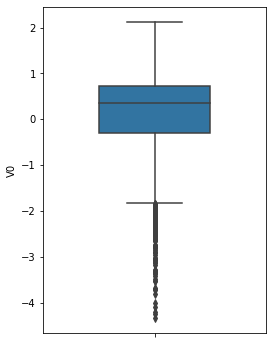

In [2]:
fig = plt.figure(figsize=(4,6)) # 绘制图形
sns.boxplot(train_data['V0'],orient="v",width=0.5)

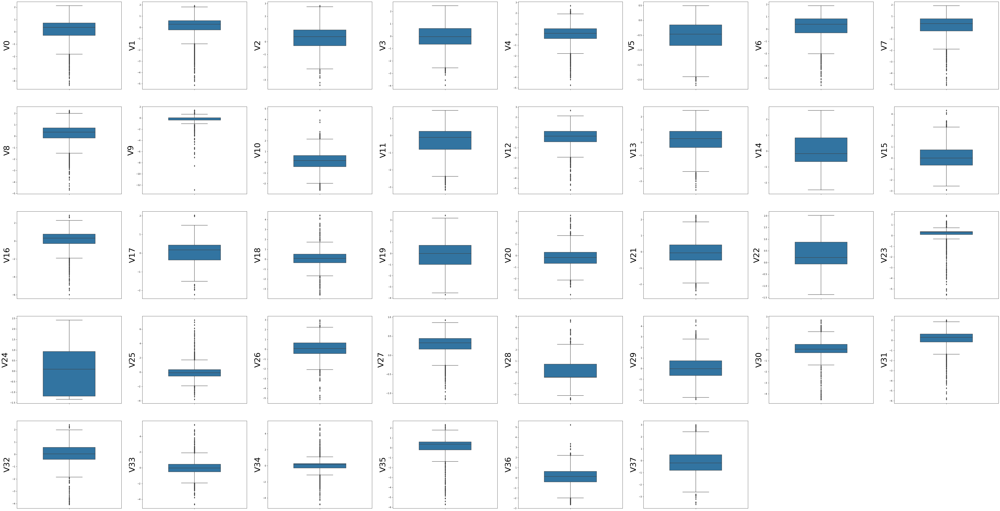

In [5]:
# 绘制每一列的箱线图
column = train_data.columns.tolist()[:39]
fig = plt.figure(figsize=(80,60),dpi=75)
for i in range(38):
    plt.subplot(7,8,i+1)
    sns.boxplot(train_data[column[i]],orient="v",width=0.5)
    plt.ylabel(column[i],fontsize=36)
plt.show()

In [ ]:
# 获取异常数据并且画图 

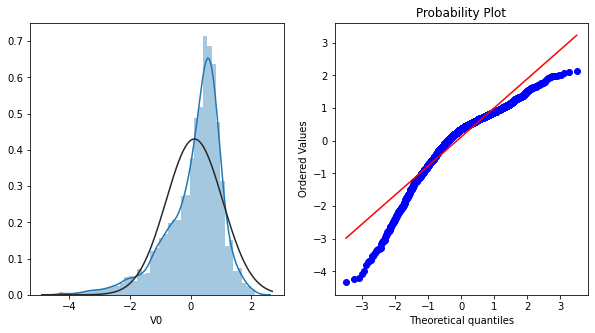

In [5]:
# 直方图的绘制
plt.figure(figsize=(10,5))
ax = plt.subplot(1,2,1)
sns.distplot(train_data['V0'],fit=stats.norm)
ax = plt.subplot(1,2,2)
res = stats.probplot(train_data['V0'],plot=plt)

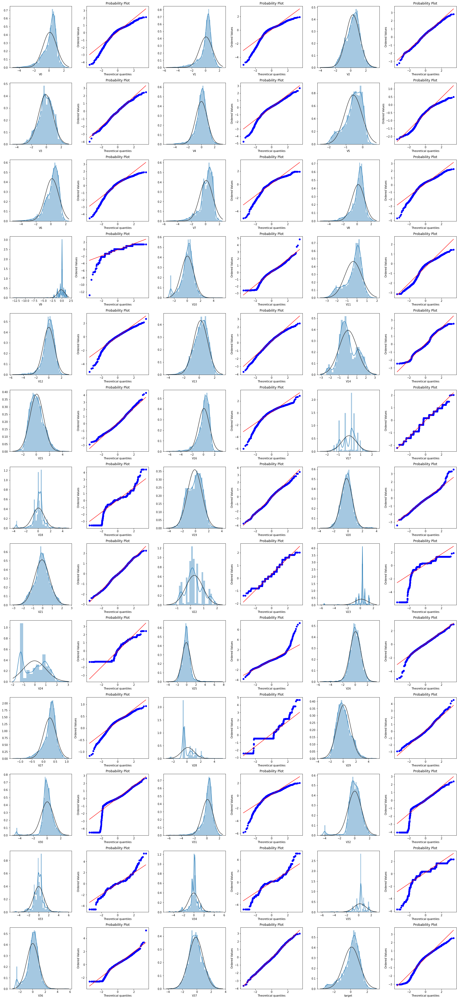

In [6]:
# 绘制所有正太分布图
train_cols = 6
train_rows = len(train_data.columns)
plt.figure(figsize=(4 * train_cols,4 * train_rows))

i = 0
for col in train_data.columns:
    i = i + 1
    ax = plt.subplot(train_rows,train_cols,i) 
    sns.distplot(train_data[col],fit=stats.norm)

    i = i + 1
    ax = plt.subplot(train_rows,train_cols,i) 
    res = stats.probplot(train_data[col],plot=plt)
plt.tight_layout()
plt.show()

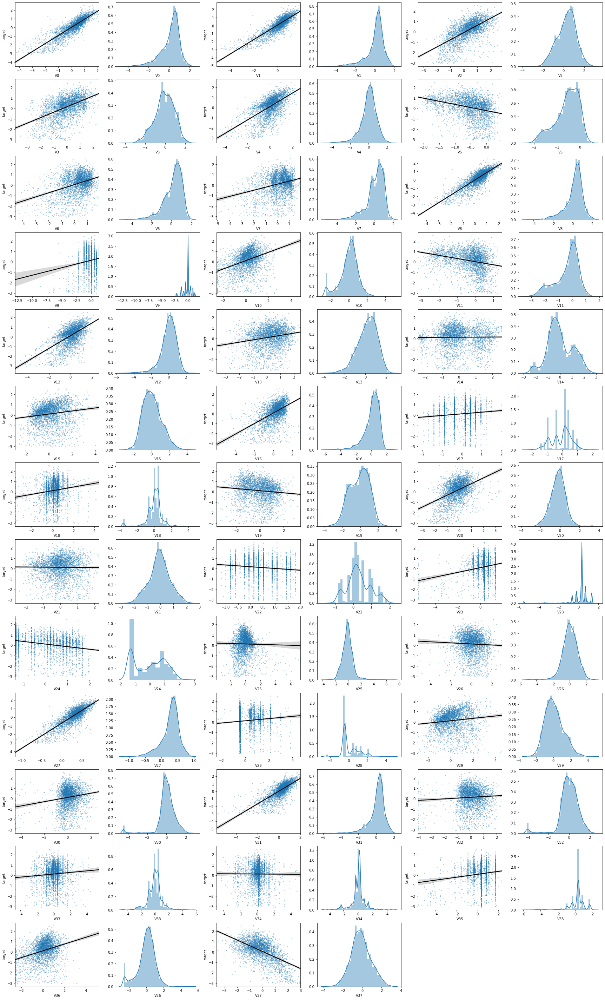

In [7]:
# 查看所有特征与target变量之间的线性关系
fcols = 6
frows = len(test_data.columns)
plt.figure(figsize=(5 * fcols,4 * frows))

i = 0
for col in test_data.columns:
    i = i + 1
    ax = plt.subplot(frows,fcols,i) 
    sns.regplot(x=col,y='target',data=train_data,ax=ax,scatter_kws={'marker':'.','s':3,'alpha':0.3},line_kws={'color':'k'});
    plt.xlabel(col)
    plt.ylabel('target')
    i = i + 1
    ax = plt.subplot(frows,fcols,i)
    sns.distplot(train_data[col].dropna())
    plt.xlabel(col)

In [8]:
# 删除无关的特征变量
data_train1 = train_data.drop(['V5','V9','V11','V17','V22','V28'],axis = 1)
train_corr = data_train1.corr()
train_corr

,V0,V1,V2,V3,V4,V6,V7,V8,V10,V12,...,V29,V30,V31,V32,V33,V34,V35,V36,V37,target
V0,1.000000,0.908607,0.463643,0.409576,0.781212,0.189267,0.141294,0.794013,0.298443,0.751830,...,0.302145,0.156968,0.675003,0.050951,0.056439,-0.019342,0.138933,0.231417,-0.494076,0.873212
V1,0.908607,1.000000,0.506514,0.383924,0.657790,0.276805,0.205023,0.874650,0.310120,0.656186,...,0.147096,0.175997,0.769745,0.085604,0.035129,-0.029115,0.146329,0.235299,-0.494043,0.871846
V2,0.463643,0.506514,1.000000,0.410148,0.057697,0.615938,0.477114,0.703431,0.346006,0.059941,...,-0.275764,0.175943,0.653764,0.033942,0.050309,-0.025620,0.043648,0.316462,-0.734956,0.638878
V3,0.409576,0.383924,0.410148,1.000000,0.315046,0.233896,0.197836,0.411946,0.321262,0.306397,...,0.117610,0.043966,0.421954,-0.092423,-0.007159,-0.031898,0.080034,0.324475,-0.229613,0.512074
V4,0.781212,0.657790,0.057697,0.315046,1.000000,-0.117529,-0.052370,0.449542,0.141129,0.927685,...,0.659093,0.022807,0.447016,-0.026186,0.062367,0.028659,0.100010,0.113609,-0.031054,0.603984
V6,0.189267,0.276805,0.615938,0.233896,-0.117529,1.000000,0.917502,0.468233,0.415660,-0.087312,...,-0.467980,0.188907,0.546535,0.144550,0.054210,-0.002914,0.044992,0.433804,-0.404817,0.370037
V7,0.141294,0.205023,0.477114,0.197836,-0.052370,0.917502,1.000000,0.389987,0.310982,-0.036791,...,-0.311363,0.170113,0.475254,0.122707,0.034508,-0.019103,0.111166,0.340479,-0.292285,0.287815
V8,0.794013,0.874650,0.703431,0.411946,0.449542,0.468233,0.389987,1.000000,0.419703,0.420557,...,-0.011091,0.150258,0.878072,0.038430,0.026843,-0.036297,0.179167,0.326586,-0.553121,0.831904
V10,0.298443,0.310120,0.346006,0.321262,0.141129,0.415660,0.310982,0.419703,1.000000,0.140462,...,-0.105042,-0.036705,0.560213,-0.093213,0.016739,-0.026994,0.026846,0.922190,-0.045851,0.394767
V12,0.751830,0.656186,0.059941,0.306397,0.927685,-0.087312,-0.036791,0.420557,0.140462,1.000000,...,0.666775,0.028866,0.441963,-0.007658,0.046674,0.010122,0.081963,0.112150,-0.054827,0.594189


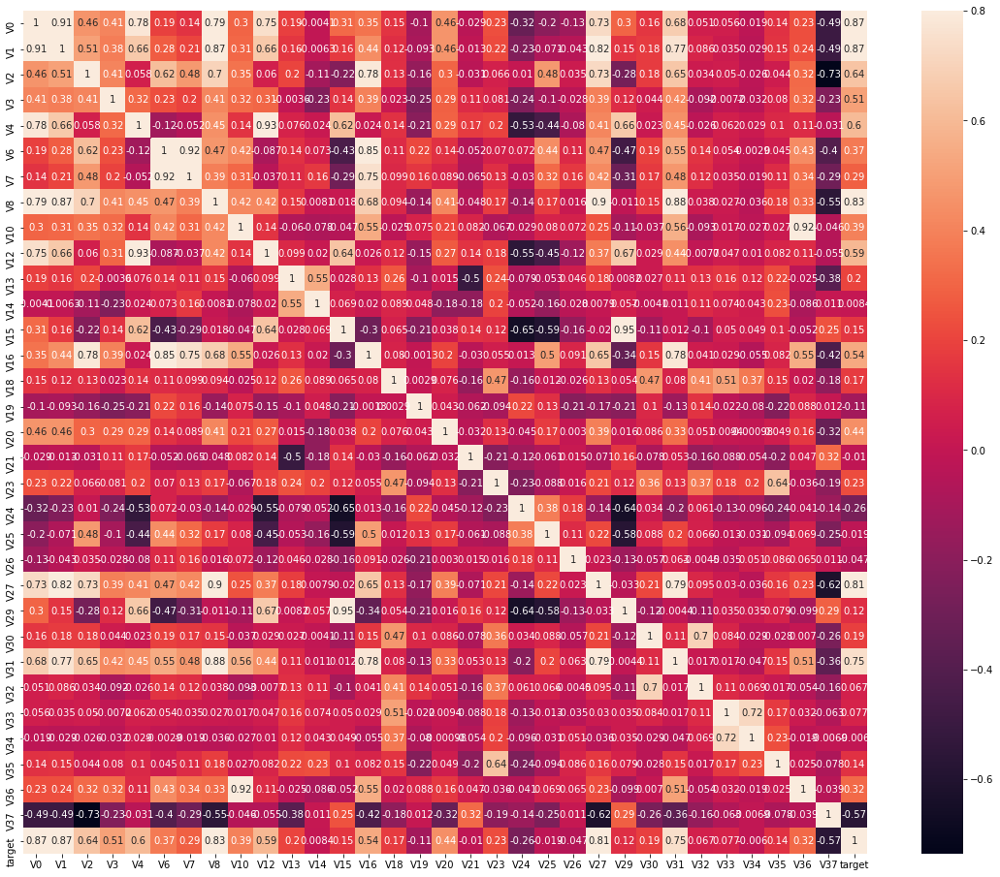

In [9]:
# 绘制出相关热力图
ax = plt.subplots(figsize=(20,16))
ax = sns.heatmap(train_corr,vmax=.8,square=True,annot=True)
annot = True

In [ ]:
# 找出与target相关性最相关的特征 变量
k = 10
cols = train_corr.nlargest(k,'target')['target'].index

cm = np.corrcoef(train_data[cols].values.T)
hm = plt.shubplots(figsize=(10,10)) #调整画布大小
hm = sns.heatmap(train_data[cols].corr(),annot=True,square=True)
plt.show()